<a href="https://colab.research.google.com/github/AleOi2/PSI3472/blob/master/EPUnet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
import numpy as np
import PIL
from PIL import Image
import os
import cv2
# import tensorflow.keras as keras
import keras
from keras import optimizers
from keras.models import*
from keras.layers import*
import sys
import os; os.environ['TF_CPP_MIN_LOG_LEVEL']='3'
import datetime
!pip install tensorboardcolab # to install tensorboeadcolab if it does not it not exist

drive.mount('/content/drive')

bdDir = "/content/drive/My Drive/Colab Notebooks/psi3472/EP/EPFinal/feiFrontG2C/"


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
def ParentFormater(tipo = "", formato= ".jpg"):
  def Formater(convert):
    def geraNome(*args, **kargs):
      numberString = convert(args[0], args[1])
      return(numberString + tipo + formato)
    return geraNome
  return Formater

@ParentFormater("ac", ".jpg")
def convertNumberAC(number, decimais): 
  return str(number).zfill(decimais) 

@ParentFormater("al", ".jpg")
def convertNumberAL(number, decimais): 
  return str(number).zfill(decimais) 

@ParentFormater("bc", ".jpg")
def convertNumberBC(number, decimais): 
  return str(number).zfill(decimais) 

@ParentFormater("bl", ".jpg")
def convertNumberBL(number, decimais): 
  return str(number).zfill(decimais) 

def readImages(nl, nc, nC, n):
  AXNormal=np.empty((n,nl,nc),dtype='float32')
  AXHappy=np.empty((n,nl,nc),dtype='float32')
  
  AYNormal=np.empty((n,nl,nc, 2),dtype='float32')
  AYHappy=np.empty((n,nl,nc, 2),dtype='float32')

  for index in range(0, 200):
    # Normal face
    # img = Image.open(os.path.join(bdDir, convertNumberAC(index + 1, 3)))
    # img = img.resize((nl, nc), Image.ANTIALIAS)
    img = cv2.imread(os.path.join(bdDir, convertNumberAC(index + 1, 3)))
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, dsize=(nc, nl), interpolation=cv2.INTER_CUBIC)
    # To LAB Color
    AYNormal[index]=cv2.cvtColor( np.float32(np.array(img)/255.0), cv2.COLOR_RGB2LAB)[:,:,1:2]/128.0
    # Gray Scale
    # img = Image.open(os.path.join(bdDir, convertNumberAL(index + 1, 3)))
    # img = cv2.cvtColor(np.array(img), cv2.COLOR_GRAY2RGB)
    AXNormal[index] = cv2.cvtColor( np.float32(np.array(img)/255.0), cv2.COLOR_RGB2LAB)[:,:,0]/100.0 - .5

    # Happy Face
    # To LAB Color
    # img = Image.open(os.path.join(bdDir, convertNumberBC(index + 1, 3)))    
    # img = img.resize((nl, nc), Image.ANTIALIAS)
    img = cv2.imread(os.path.join(bdDir, convertNumberBC(index + 1, 3)))
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, dsize=(nc, nl), interpolation=cv2.INTER_CUBIC)

    AYHappy[index]=cv2.cvtColor( np.float32(np.array(img)/255.0), cv2.COLOR_RGB2LAB)[:,:,1:2]/128.0
    # Gray Scale
    # img = Image.open(os.path.join(bdDir, convertNumberBL(index + 1, 3)))
    # img = cv2.cvtColor(np.array(img), cv2.COLOR_GRAY2RGB)
    AXHappy[index]=cv2.cvtColor( np.float32(np.array(img)/255.0), cv2.COLOR_RGB2LAB)[:,:,0]/100.0 - .5

  return (AXNormal, AYNormal, AXHappy, AYHappy)

def TrainTestSpliter(AXNormal, AYNormal, AXHappy, AYHappy):
  # Train:  001 a 100 
  AX_Train = np.concatenate((AXNormal[0:99], AXHappy[0:99]))
  AY_Train = np.concatenate((AYNormal[0:99], AYHappy[0:99]))
  print("Treino")
  print(AX_Train.shape)
  print(AY_Train.shape)

  # Validate: 101 a 150
  AX_Valid = np.concatenate((AXNormal[100:149], AXHappy[100:149]))
  AY_Valid = np.concatenate((AYNormal[100:149], AYHappy[100:149]))
  print("Validação")
  print(AX_Valid.shape)
  print(AY_Valid.shape)

  # Test: 151 a 200
  AX_Test = np.concatenate((AXNormal[150:199], AXHappy[150:199]))
  AY_Test = np.concatenate((AYNormal[150:199], AYHappy[150:199]))
  print("Teste")
  print(AX_Test.shape)
  print(AY_Test.shape)
  return (AX_Train, AY_Train, AX_Valid, AY_Valid, AX_Test, AY_Test)

# Unet
def Segmentacao(input_size = (32,32,1)):
  n=40
  inputs = Input(input_size) 
  conv2 = Conv2D(n, 3, activation = 'relu', padding = 'same' )(inputs)
  conv2 = Dropout(0.5)(conv2) 
  conv2 = Conv2D(n, 3, activation = 'relu', padding = 'same' )(conv2)
  conv2 = Dropout(0.5)(conv2) 
  conv2 = BatchNormalization()(conv2)
  pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)  

  conv3 = Conv2D(2*n, 3, activation = 'relu', padding = 'same' )(pool2) 
  conv3 = Dropout(0.5)(conv3) 
  conv3 = Conv2D(2*n, 3, activation = 'relu', padding = 'same' )(conv3)
  conv3 = Dropout(0.5)(conv3) 
  conv3 = BatchNormalization()(conv3)
  pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)  

  conv4 = Conv2D(4*n, 3, activation = 'relu', padding = 'same' )(pool3) 
  conv4 = Dropout(0.5)(conv4) 
  conv4 = Conv2D(4*n, 3, activation = 'relu', padding = 'same' )(conv4)
  conv4 = Dropout(0.5)(conv4) 
  conv4 = BatchNormalization()(conv4)
  pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)  

  conv5 = Conv2D(8*n, 3, activation = 'relu', padding = 'same' )(pool4) 
  conv5 = Dropout(0.5)(conv5) 
  conv5 = Conv2D(8*n, 3, activation = 'relu', padding = 'same' )(conv5) 
  conv5 = Dropout(0.5)(conv5) 

  up6 = Conv2D(4*n, 2, activation = 'relu', padding = 'same')(UpSampling2D(size = (2,2))(conv5)) 
  merge6 = concatenate([conv4,up6], axis = 3) 
  conv6 = Conv2D(4*n, 3, activation = 'relu', padding = 'same' )(merge6)
  conv6 = Dropout(0.5)(conv6) 
  conv6 = Conv2D(4*n, 3, activation = 'relu', padding = 'same' )(conv6) 
  conv6 = Dropout(0.5)(conv6) 

  up7 = Conv2D(2*n, 2, activation = 'relu', padding = 'same')(UpSampling2D(size = (2,2))(conv6)) 
  merge7 = concatenate([conv3,up7], axis = 3)
  conv7 = Conv2D(2*n, 3, activation = 'relu', padding = 'same' )(merge7)
  conv7 = Dropout(0.5)(conv7) 
  conv7 = Conv2D(2*n, 3, activation = 'relu', padding = 'same' )(conv7) 
  conv7 = Dropout(0.5)(conv7) 

  up8 = Conv2D(n, 2, activation = 'relu', padding = 'same'
              )(UpSampling2D(size = (2,2))(conv7)) 
  merge8 = concatenate([conv2,up8], axis = 3)
  conv8 = Conv2D(n, 3, activation = 'relu', padding = 'same' )(merge8)
  conv8 = Dropout(0.5)(conv8) 
  conv8 = Conv2D(n, 3, activation = 'relu', padding = 'same' )(conv8) 
  conv8 = Dropout(0.5)(conv8) 

  conv9 = Conv2D(2, 1, activation = 'sigmoid', padding = 'same' )(conv8) 

  model = Model(inputs = inputs, outputs = conv9)
  model.compile(optimizer = keras.optimizers.Adam(lr = 1e-3),
  loss = 'mean_squared_error', metrics = ['accuracy'])
  from keras.utils import plot_model
  plot_model(model, to_file='unet-train1.png', show_shapes=True)
  model.summary()
  return model

if __name__ == "__main__":
  # line, col, number color(rgb), n(number of images)  
  # nl, nc, nC, n = 96, 64, 3, 201
  # nl, nc, nC, n = 384, 256, 3, 201
  nl, nc, nC, n = 192, 128, 3, 201
  # Read Images
  (AXNormal, AYNormal, AXHappy, AYHappy) = readImages(nl, nc, nC, n)  
  # Train Test Validate Spliter
  (AX_Train, AY_Train, AX_Valid \
   , AY_Valid, AX_Test, AY_Test) = TrainTestSpliter(AXNormal, AYNormal, \
                                                          AXHappy, AYHappy)
  print("Train Test Validation Finished")
  model = Segmentacao((nl, nc, 1))
  # model = load_model("unet1.h5")
  
  NewAX_Train = np.expand_dims(AX_Train, axis = 3)
  NewAX_Valid = np.expand_dims(AX_Valid, axis = 3)
  NewAX_Test = np.expand_dims(AX_Test, axis = 3)

  logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  tensorboard_callback = keras.callbacks.TensorBoard(logdir, histogram_freq=1)

  model.fit(
      NewAX_Train, AY_Train, batch_size=30, epochs=300, verbose=True,
      validation_data=(NewAX_Valid,AY_Valid), callbacks=[tensorboard_callback]);
  score = model.evaluate(NewAX_Train, AY_Train, verbose=0); print('Training loss:', score)
  score = model.evaluate(NewAX_Valid, AY_Valid, verbose=0); print('Validation loss:', score)
  score = model.evaluate(NewAX_Test, AY_Test, verbose=0); print('Test loss:', score)
  model.save("unet1.h5");



Treino
(198, 192, 128)
(198, 192, 128, 2)
Validação
(98, 192, 128)
(98, 192, 128, 2)
Teste
(98, 192, 128)
(98, 192, 128, 2)
Train Test Validation Finished
Model: "functional_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 192, 128, 1) 0                                            
__________________________________________________________________________________________________
conv2d_36 (Conv2D)              (None, 192, 128, 40) 400         input_3[0][0]                    
__________________________________________________________________________________________________
dropout_28 (Dropout)            (None, 192, 128, 40) 0           conv2d_36[0][0]                  
__________________________________________________________________________________________________
conv2d_37 (Conv2D)             

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs

# Prediction Test

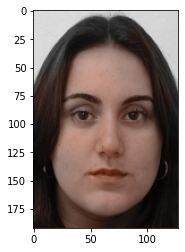

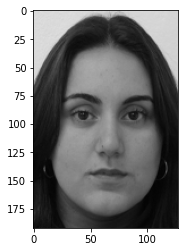

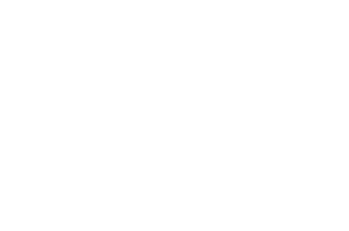

In [ ]:
curDir = "/content/drive/My Drive/Colab Notebooks/psi3472/EP/EPFinal/"
model = load_model("unet1.h5")

# Accept only one image to predict
def ImageTester(img, id):
  def convertInputImage():
    return np.expand_dims(np.array(img), axis = 3) 
  input = convertInputImage()
  image = model.predict(input)
  input = input[0]
  colorized = np.concatenate(((0.5 + input[:, :]) * 100.0, ( np.array(image[0]) ) * 128.0), axis=2)
  image = cv2.cvtColor(colorized, cv2.COLOR_LAB2RGB)

  from matplotlib import pyplot as plt

  f = plt.figure()
  # f.add_subplot(numrow,numcol,index + 1)
  # f.set_figheight(15)
  # f.set_figwidth(15)

  plt.imshow(image)
  plt.show()
  AXImg = np.expand_dims((AXNormal[id:id + 1] + .5) * 100, axis=3)
  result = np.concatenate((AXImg, np.zeros((AYNormal[id:id + 1].shape))), axis = 3)
  imageBlackWhite = cv2.cvtColor(np.float32(result[0]), cv2.COLOR_LAB2RGB)

  f = plt.figure()
  plt.imshow(imageBlackWhite)
  plt.show()
  plt.axis('off')


id = 160
ImageTester([AXNormal[id]], id)



# Faces

In [ ]:
  def printImage(images, numrow, numcol):
    from matplotlib import pyplot as plt
    if len(images.shape) == 4: 
      f = plt.figure()
      xDimension = images.shape[2]
      yDimension = images.shape[3]
      imgNum = images.shape[0]

      for index in range(0, imgNum):
        f.add_subplot(numrow,numcol,index + 1)
        f.set_figheight(100)
        f.set_figwidth(100)
        img = images[index,:,:,:]
        plt.imshow(img)
        plt.axis('off')
      plt.show()
    elif len(images.shape) == 3:
      f = plt.figure()
      xDimension = images.shape[1]
      yDimension = images.shape[2]
      imgNum = images.shape[0]

      for index in range(0, imgNum):
        f.add_subplot(numrow,numcol,index + 1)
        f.set_figheight(100)
        f.set_figwidth(100)
        img = images[index,:,:] 
        plt.imshow(img)
        plt.axis('off')
      plt.show()

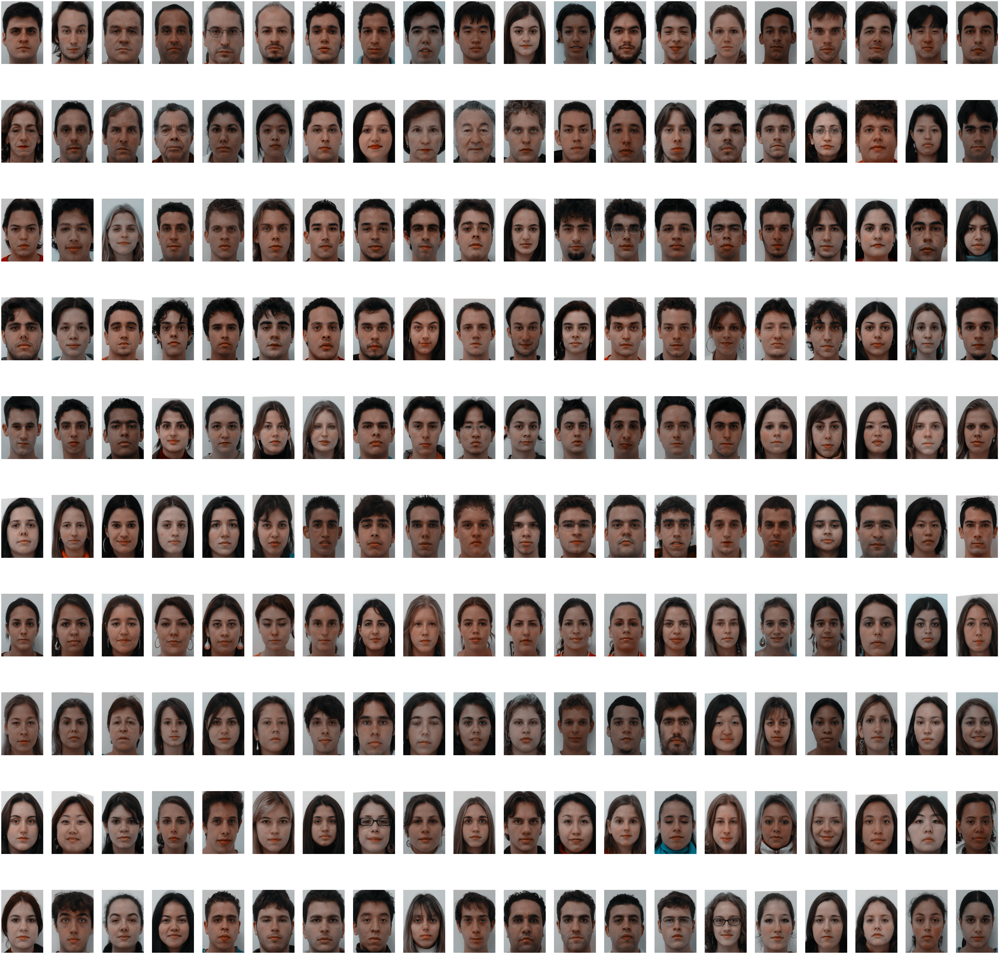

In [ ]:
# ColorFul image
from skimage import color

numSamples = 200
AXNormalExpanded = np.expand_dims(AXNormal[0:numSamples], axis=3)
result = np.concatenate(((0.5 + AXNormalExpanded) * 100, AYNormal[0:numSamples] * 128), axis = 3)
sampleAYNormal = [cv2.cvtColor(np.float32(result[index]), cv2.COLOR_LAB2RGB) for index in range(0, result.shape[0])]
printImage(np.array(sampleAYNormal) , 10,20)

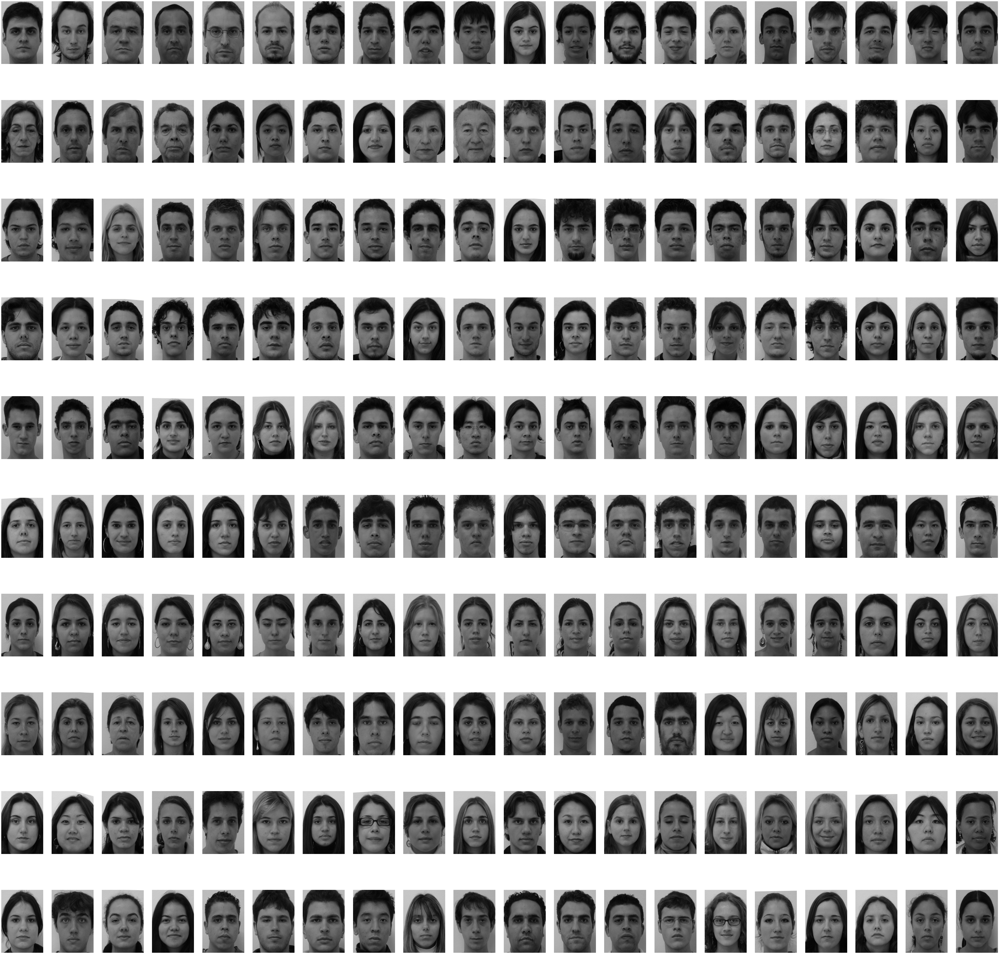

In [ ]:
# Normal Faces - Black and White
from skimage import color

numSamples = 200
AXNormalExpanded = np.expand_dims(AXNormal[0:numSamples], axis=3)
result = np.concatenate(((AXNormalExpanded + 0.5) * 100, np.zeros((AYNormal[0:numSamples].shape))), axis = 3)
sampleAYNormal = [cv2.cvtColor(np.float32(result[index]), cv2.COLOR_LAB2RGB) for index in range(0, result.shape[0])]

printImage(np.array(sampleAYNormal), 10,20)

In [ ]:
# Normal Faces 
from skimage import color
numSamples = 200
AXHappyExpanded = np.expand_dims(AXHappy[0:numSamples], axis=3)
result = np.concatenate(((0.5 + AXHappyExpanded) * 100, 128 * AYHappy[0:numSamples]), axis = 3)
sampleAYHappy = [cv2.cvtColor(np.float32(result[index]), cv2.COLOR_LAB2RGB) for index in range(0, result.shape[0])]
printImage(np.array(sampleAYHappy) , 10,20)

In [ ]:
# Happy Faces - Black and White
numSamples = 200
AXHappyExpanded = np.expand_dims(AXNormal[0:numSamples], axis=3)
result = np.concatenate(((AXHappyExpanded + 0.5) * 100, np.zeros((AYHappy[0:numSamples].shape))), axis = 3)
sampleAYHappy = [cv2.cvtColor(np.float32(result[index]), cv2.COLOR_LAB2RGB) for index in range(0, result.shape[0])]

printImage(np.array(sampleAYHappy), 10,20)